In [1]:
from minisom import MiniSom
import xarray as xr
import numpy as np
import pandas as pd
from matplotlib.pylab import *
import matplotlib.pyplot as plt
%matplotlib inline
from scipy import stats
import time
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

In [2]:
data = xr.open_dataset('raw_data.nc4')
data

<xarray.Dataset>
Dimensions:        (latitude: 77897600, minPressure: 77897600, precipitation: 77897600, radius: 77897600, sst: 77897600, theta: 77897600)
Coordinates:
  * precipitation  (precipitation) float64 0.9693 0.62 0.46 ... 1.36 0.98 0.0
  * radius         (radius) float64 748.6 729.4 710.7 ... 703.3 722.4 742.0
  * theta          (theta) float64 0.6215 0.6481 0.6761 ... 1.04 1.011 0.9845
  * minPressure    (minPressure) float32 997.0 997.0 997.0 ... 998.0 998.0 998.0
  * latitude       (latitude) float32 -12.3 -12.3 -12.3 ... -16.4 -16.4 -16.4
  * sst            (sst) float32 29.06 29.06 29.06 29.06 ... 29.71 29.71 29.71
Data variables:
    *empty*

In [3]:
idx = np.where(data.radius <= 500)[0]

In [4]:
pmin = data.minPressure.values[idx].reshape(-1,1)
lat = data.latitude.values[idx].reshape(-1,1)
sst = data.sst.values[idx].reshape(-1,1)
dist = data.radius[idx].values.reshape(-1,1)
ang = data.theta.values[idx].reshape(-1,1)

In [5]:
variables = {'Precipitation': data.precipitation.values[idx].reshape(-1,1).ravel(),
             'Radius': dist.ravel(),
             'Theta': ang.ravel(),
             'MinPressure': pmin.ravel(),
             'SST': sst.ravel() ,
             'Latitude': lat.ravel()}

data = pd.DataFrame(variables, columns = ['Precipitation','Radius', 'Theta', 'MinPressure', 'SST', 'Latitude'])
data = data.dropna()

In [6]:
data = data[data.MinPressure > 0]
data.shape

(48308423, 6)

# Clasificación de las variables Pmin,Lat,SST

#### Clasificación presión

In [7]:
unique, counts = np.unique(data.MinPressure, return_counts= True)#135
unique

array([ 872.,  878.,  882.,  885.,  886.,  890.,  892.,  895.,  896.,
        897.,  899.,  900.,  901.,  902.,  903.,  904.,  905.,  906.,
        907.,  908.,  909.,  910.,  912.,  913.,  914.,  915.,  916.,
        917.,  918.,  919.,  920.,  921.,  922.,  923.,  924.,  925.,
        926.,  927.,  928.,  929.,  930.,  931.,  932.,  933.,  934.,
        935.,  936.,  937.,  938.,  939.,  940.,  941.,  942.,  943.,
        944.,  945.,  946.,  947.,  948.,  949.,  950.,  951.,  952.,
        953.,  954.,  955.,  956.,  957.,  958.,  959.,  960.,  961.,
        962.,  963.,  964.,  965.,  966.,  967.,  968.,  969.,  970.,
        971.,  972.,  973.,  974.,  975.,  976.,  977.,  978.,  979.,
        980.,  981.,  982.,  983.,  984.,  985.,  986.,  987.,  988.,
        989.,  990.,  991.,  992.,  993.,  994.,  995.,  996.,  997.,
        998.,  999., 1000., 1001., 1002., 1003., 1004., 1005., 1006.,
       1007., 1008., 1009., 1010., 1011., 1012., 1013., 1014., 1015.,
       1016., 1017.,

In [8]:
lista = []
for i in range(0,135,2):
    lista.append(unique[i])
unique = np.setdiff1d(unique,lista)
for i in range(0,67,2):
    lista.append(unique[i])
pres = np.array(lista)
pres = np.sort(pres[2:102])
pres

array([ 878.,  886.,  890.,  892.,  896.,  897.,  899.,  901.,  902.,
        903.,  905.,  906.,  907.,  909.,  910.,  912.,  914.,  915.,
        916.,  918.,  919.,  920.,  922.,  923.,  924.,  926.,  927.,
        928.,  930.,  931.,  932.,  934.,  935.,  936.,  938.,  939.,
        940.,  942.,  943.,  944.,  946.,  947.,  948.,  950.,  951.,
        952.,  954.,  955.,  956.,  958.,  959.,  960.,  962.,  963.,
        964.,  966.,  967.,  968.,  970.,  971.,  972.,  974.,  975.,
        976.,  978.,  979.,  980.,  982.,  983.,  984.,  986.,  987.,
        988.,  990.,  991.,  992.,  994.,  995.,  996.,  998.,  999.,
       1000., 1002., 1003., 1004., 1006., 1007., 1008., 1010., 1011.,
       1012., 1014., 1015., 1016., 1018., 1019., 1020., 1022., 1023.,
       1024.], dtype=float32)

#### Clasificación SST

In [9]:
id1 = np.unique(data.SST)[np.unique(data.SST)-np.unique(data.SST).astype(int) == 0]
id2 = np.unique(data.SST)[np.unique(data.SST)-np.unique(data.SST).astype(int) == 0.25]
id3 = np.unique(data.SST)[np.unique(data.SST)-np.unique(data.SST).astype(int) == 0.5]
id4 = np.unique(data.SST)[np.unique(data.SST)-np.unique(data.SST).astype(int) == 0.75]
id5 = np.unique(data.SST)[np.round(np.unique(data.SST)-np.unique(data.SST).astype(int),decimals = 2) == 0.1]

In [10]:
sst = np.sort(np.concatenate((id1,id2,id3,id4,id5)))
sst

array([ 3.25    ,  3.5     ,  7.1     ,  7.5     ,  8.099999,  9.099999,
        9.25    ,  9.5     ,  9.75    , 10.      , 10.099999, 10.5     ,
       10.75    , 11.25    , 12.099999, 12.25    , 13.      , 13.099999,
       13.25    , 13.75    , 14.      , 14.25    , 14.75    , 15.25    ,
       15.75    , 16.      , 16.25    , 17.      , 17.1     , 17.25    ,
       17.5     , 17.75    , 18.      , 18.1     , 18.25    , 18.5     ,
       18.75    , 19.      , 19.1     , 19.25    , 19.5     , 19.75    ,
       20.      , 20.1     , 20.25    , 20.5     , 20.75    , 21.      ,
       21.1     , 21.25    , 21.5     , 21.75    , 22.      , 22.1     ,
       22.25    , 22.5     , 22.75    , 23.      , 23.1     , 23.25    ,
       23.5     , 23.75    , 24.      , 24.1     , 24.25    , 24.5     ,
       24.75    , 25.      , 25.1     , 25.25    , 25.5     , 25.75    ,
       26.      , 26.099998, 26.25    , 26.5     , 26.75    , 27.      ,
       27.099998, 27.25    , 27.5     , 27.75    , 

#### Clasificación Latitud

In [11]:
id1 = np.unique(np.abs(data.Latitude))[np.unique(np.abs(data.Latitude))-np.unique(np.abs(data.Latitude)).astype(int) == 0]
id2 = np.unique(np.abs(data.Latitude))[np.unique(np.abs(data.Latitude))-np.unique(np.abs(data.Latitude)).astype(int) == 0.5]
lat = np.sort(np.concatenate((id1,id2)))[:100]
lat

array([ 1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5,  5. ,  5.5,  6. ,  6.5,
        7. ,  7.5,  8. ,  8.5,  9. ,  9.5, 10. , 10.5, 11. , 11.5, 12. ,
       12.5, 13. , 13.5, 14. , 14.5, 15. , 15.5, 16. , 16.5, 17. , 17.5,
       18. , 18.5, 19. , 19.5, 20. , 20.5, 21. , 21.5, 22. , 22.5, 23. ,
       23.5, 24. , 24.5, 25. , 25.5, 26. , 26.5, 27. , 27.5, 28. , 28.5,
       29. , 29.5, 30. , 30.5, 31. , 31.5, 32. , 32.5, 33. , 33.5, 34. ,
       34.5, 35. , 35.5, 36. , 36.5, 37. , 37.5, 38. , 38.5, 39. , 39.5,
       40. , 40.5, 41. , 41.5, 42. , 42.5, 43. , 43.5, 44. , 44.5, 45. ,
       45.5, 46. , 46.5, 47. , 47.5, 48. , 48.5, 49. , 49.5, 50. , 50.5,
       51. ], dtype=float32)

In [12]:
id_pres = data.MinPressure[data.MinPressure.isin(pres)].index
id_sst = data.SST[data.SST.isin(sst)].index
id_lat = data.Latitude[np.abs(data.Latitude).isin(lat)].index
idx = np.intersect1d(np.intersect1d(id_pres,id_lat),id_sst)
idx.shape

(524698,)

In [13]:
max_pres = data.MinPressure.max()
min_pres = data.MinPressure.min()
max_sst = data.SST.max()
min_sst = data.SST.min()
max_lat = np.abs(data.Latitude).max()
min_lat = np.abs(data.Latitude).min()

In [14]:
data.MinPressure = (data.MinPressure - data.MinPressure.min())/(data.MinPressure.max()-data.MinPressure.min())
data.SST = (data.SST - data.SST.min())/(data.SST.max()-data.SST.min())
data.Latitude = np.abs(data.Latitude)
data.Latitude = (data.Latitude - data.Latitude.min())/(data.Latitude.max()-data.Latitude.min())

data

,Precipitation,Radius,Theta,MinPressure,SST,Latitude
0,0.300000,496.792241,1.107676,0.822368,0.897084,0.196043
1,0.380000,489.578149,1.160811,0.822368,0.897084,0.196043
2,0.740000,483.837001,1.215370,0.822368,0.897084,0.196043
3,0.560000,479.621596,1.271073,0.822368,0.897084,0.196043
4,0.900000,476.972298,1.327603,0.822368,0.897084,0.196043
...,...,...,...,...,...,...
53011548,1.745791,489.037709,1.813848,0.828947,0.919383,0.269784
53011549,0.000000,488.724568,1.759242,0.828947,0.919383,0.269784
53011550,0.000000,489.972732,1.704670,0.828947,0.919383,0.269784
53011551,0.000000,492.770227,1.650453,0.828947,0.919383,0.269784


In [15]:
datos = data.loc[idx]

In [16]:
data

,Precipitation,Radius,Theta,MinPressure,SST,Latitude
0,0.300000,496.792241,1.107676,0.822368,0.897084,0.196043
1,0.380000,489.578149,1.160811,0.822368,0.897084,0.196043
2,0.740000,483.837001,1.215370,0.822368,0.897084,0.196043
3,0.560000,479.621596,1.271073,0.822368,0.897084,0.196043
4,0.900000,476.972298,1.327603,0.822368,0.897084,0.196043
...,...,...,...,...,...,...
53011548,1.745791,489.037709,1.813848,0.828947,0.919383,0.269784
53011549,0.000000,488.724568,1.759242,0.828947,0.919383,0.269784
53011550,0.000000,489.972732,1.704670,0.828947,0.919383,0.269784
53011551,0.000000,492.770227,1.650453,0.828947,0.919383,0.269784


In [17]:
som = MiniSom(20,20,3,sigma=1, learning_rate=.75,
             neighborhood_function='gaussian', random_seed=10)
starting_weights = som.get_weights().copy()
som.pca_weights_init(datos[['MinPressure','SST','Latitude']].values)
som.train_random(datos[['MinPressure','SST','Latitude']].values, 1000000, verbose=True)

 [     364 / 1000000 ]   0% - 0:07:53 left 

 [     624 / 1000000 ]   0% - 0:10:02 left 

 [     935 / 1000000 ]   0% - 0:10:02 left 

 [    1285 / 1000000 ]   0% - 0:09:43 left 

 [    1570 / 1000000 ]   0% - 0:09:56 left 

 [    1873 / 1000000 ]   0% - 0:10:00 left 

 [    2125 / 1000000 ]   0% - 0:10:16 left 

 [ 1000000 / 1000000 ] 100% - 0:00:00 left 
 quantization error: 0.014263551238269974


In [18]:
win_map = som.win_map(datos[['MinPressure','SST','Latitude']].values)

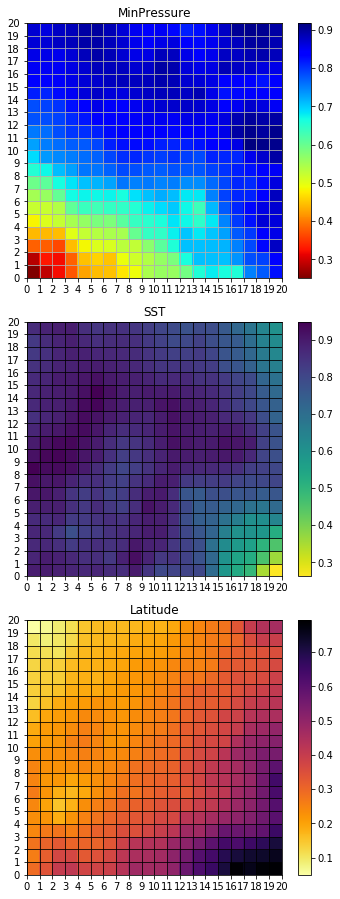

In [19]:
feature_names = ['MinPressure','SST','Latitude']
colors = ['jet_r','viridis_r','inferno_r']
size = 20
W = som.get_weights()
plt.figure(figsize=(5, 16.5))
for i, f in enumerate(feature_names):
    plt.subplot(4, 1, i+1)
    plt.title(f)
    plt.pcolor(W[:,:,i].T, cmap= colors[i])
    plt.xticks(np.arange(size+1))
    plt.yticks(np.arange(size+1))
    plt.colorbar()
    plt.rc('grid', linestyle="-", color='black')
    plt.grid()
    
plt.tight_layout()
plt.show()

In [20]:
W[:,:,0] = W[:,:,0]*(max_pres-min_pres) + min_pres
W[:,:,1] = W[:,:,1]*(max_sst-min_sst) + min_sst
W[:,:,2] = W[:,:,2]*(max_lat-min_lat) + min_lat

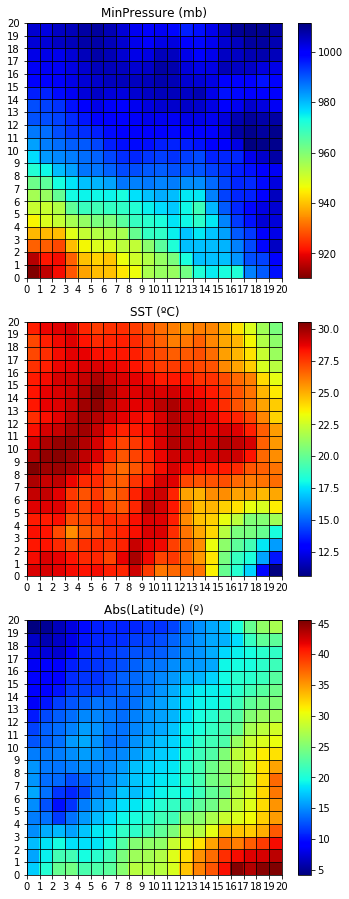

In [21]:
feature_names = ['MinPressure (mb)','SST (ºC)','Abs(Latitude) (º)']
colors = ['jet_r','jet','jet']
size = 20
W = som.get_weights()
fig = plt.figure(figsize=(5, 16.5))
for i, f in enumerate(feature_names):
    plt.subplot(4, 1, i+1)
    plt.title(f)
    plt.pcolor(W[:,:,i].T, cmap= colors[i])
    plt.xticks(np.arange(size+1))
    plt.yticks(np.arange(size+1))
    plt.colorbar()
    plt.rc('grid', linestyle="-", color='black')
    plt.grid()
    
plt.tight_layout()
plt.show()

In [22]:
fig.savefig('som_cells.png')

### Desnormalización de las variables

In [23]:
data.MinPressure = data.MinPressure*(max_pres-min_pres) + min_pres
data.SST = data.SST*(max_sst-min_sst) + min_sst
data.Latitude = data.Latitude*(max_lat-min_lat) + min_lat
data

,Precipitation,Radius,Theta,MinPressure,SST,Latitude
0,0.300000,496.792241,1.107676,997.0,29.059999,12.3
1,0.380000,489.578149,1.160811,997.0,29.059999,12.3
2,0.740000,483.837001,1.215370,997.0,29.059999,12.3
3,0.560000,479.621596,1.271073,997.0,29.059999,12.3
4,0.900000,476.972298,1.327603,997.0,29.059999,12.3
...,...,...,...,...,...,...
53011548,1.745791,489.037709,1.813848,998.0,29.709999,16.4
53011549,0.000000,488.724568,1.759242,998.0,29.709999,16.4
53011550,0.000000,489.972732,1.704670,998.0,29.709999,16.4
53011551,0.000000,492.770227,1.650453,998.0,29.709999,16.4


##### Automatización

In [24]:
z=30
k = np.zeros(z)
r = np.zeros(z)
a = np.zeros(z)
for i in range(1,z):
    k[0] = 20
    r[0] = 35
    a[0] = 0
    k[i] = (i+1)*k[0]
    a[i] = (np.pi*(2*i+1+2*np.sqrt(i*(i+1))))/k[0]
    r[i] = np.sqrt((i+1)/i)*r[i-1]
r  

array([ 35.        ,  49.49747468,  60.62177826,  70.        ,
        78.26237921,  85.732141  ,  92.60129589,  98.99494937,
       105.        , 110.67971811, 116.08186766, 121.24355653,
       126.19429464, 130.95800854, 135.55441712, 140.        ,
       144.3086969 , 148.49242405, 152.56146302, 156.52475842,
       160.39014932, 164.16455159, 167.85410332, 171.46428199,
       175.        , 178.46568298, 181.86533479, 185.20259177,
       188.48076825, 191.70289513])

In [25]:
rad = r
rad = np.sort(np.append(rad,0))
rad = rad*2.6
rad

array([  0.        ,  91.        , 128.69343418, 157.61662349,
       182.        , 203.48218595, 222.90356659, 240.76336931,
       257.38686835, 273.        , 287.76726708, 301.81285592,
       315.23324698, 328.10516607, 340.4908222 , 352.4414845 ,
       364.        , 375.20261193, 386.08030253, 396.65980386,
       406.9643719 , 417.01438824, 426.82783414, 436.42066862,
       445.80713319, 455.        , 464.01077574, 472.84987047,
       481.52673861, 490.04999745, 498.42752733])

In [26]:
pres_w = W[:,:,0]
sst_w = W[:,:,1]
lat_w = W[:,:,2]

In [27]:
def roundup(x):
    return int(np.ceil(x / 10.0)) * 10

def roundown(x):
    return int(np.floor(x / 10.0)) * 10

def roundlat(x):
    if x-roundown(x) <= 5:
        return int(np.floor(x / 10.0)) * 10
    else:
        return int(np.ceil(x / 10.0)) * 10

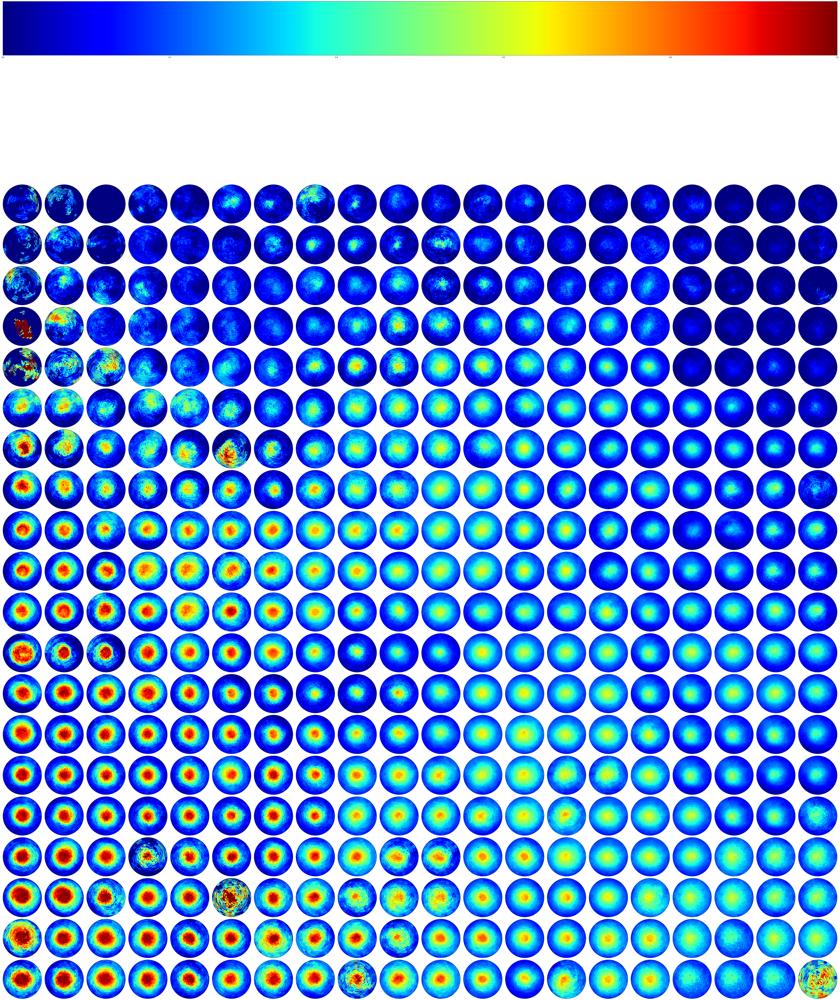

--- 1923.6567199230194 seconds ---


In [28]:
start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = rad #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta


#creamos fig,axs

fig, axes = plt.subplots(20, 20, figsize=(80,80), subplot_kw=dict(polar=True))


for u in range(0,20):
    for v in range(0,20): 
        total_obs = []

        pres_low = roundown(pres_w[u,v])
        pres_up = roundup(pres_w[u,v])
        if np.abs(pres_low - pres_w[u,v]) > 5:
            pres_low = pres_low + 5
        else:
            pres_up = pres_up - 5
        sst_low = np.floor(sst_w[u,v])
        sst_up = np.ceil(sst_w[u,v])
        if lat_w[u,v] <= roundlat(lat_w[u,v]):
            lat_low = roundlat(lat_w[u,v])-5
            lat_up = roundlat(lat_w[u,v])
        else:
            lat_low = roundlat(lat_w[u,v])
            lat_up = roundlat(lat_w[u,v])+5

        
        if pres_up <= 911:
            pres_up = 911
            pres_low = 800
        if pres_low >= 1010:
            pres_up = 1200
            pres_low = 1010
        if sst_up > 31:
            sst_up = 32
            sst_low = 31
        
        datos = data[((data.MinPressure > pres_low) & (data.MinPressure <=pres_up)) & ((data.SST > sst_low) &(data.SST <= sst_up)) 
     & ((data.Latitude > lat_low) & (data.Latitude <= lat_up))]
        
#         datos = data[(data.MinPressure == pres_w[u,v].astype(int)) & ((np.round(data.Latitude) == np.round(lat_w[u,v]))) & ((np.round(data.SST) == np.round(sst_w[u,v])))]
        
        dist = datos.Radius.values
        ang = datos.Theta.values
        pmin = datos.MinPressure.values
        lat = datos.Latitude.values
        sst = datos.SST.values
        prec = datos.Precipitation.values


        obs = np.zeros((r.shape))
                    
        for i in range(obs.shape[0]):
            for j in range(obs.shape[1]):
                if j == 30 and i == 36 :
                    index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                elif j == 30:
                    index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                elif i == 36:
                    index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                else:
            
                    index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                
                if len(index) == 0:
                    obs[i,j] == np.nan
                else:
                    
                    obs[i,j] = len(np.where(prec[index] >= 1)[0])/len(prec[index]) #cuando el index es un array vacío retorna nan, es decir no hay datos
            
        total_obs.append(obs)

        if len(datos) == 0:
        
            axes[19-u,v].set_theta_zero_location('N', offset=0)

            axes[19-u,v].set_theta_direction(-1)
    
            axes[19-u,v].set_yticklabels([])
    
            axes[19-u,v].set_xticklabels([])
        else:
        
            im = axes[19-u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='jet', vmin = 0, vmax = 1)

            axes[19-u,v].set_theta_zero_location('N', offset=0)

            axes[19-u,v].set_theta_direction(-1)
    
            axes[19-u,v].set_yticklabels([])
    
            axes[19-u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))


In [29]:
fig.savefig('matriz_prob_lluvia.png')

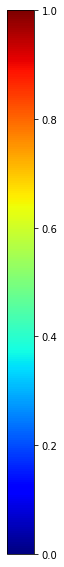

In [30]:
fig,ax = plt.subplots(figsize=(10,10))
plt.colorbar(im,ax=ax)
ax.remove()
fig.savefig('scale_jet0-1.png')

In [31]:
data = data[data.Precipitation >= 1]
data

,Precipitation,Radius,Theta,MinPressure,SST,Latitude
6,2.190000,476.460714,1.441731,997.0,29.059999,12.3
7,1.630000,478.603371,1.498592,997.0,29.059999,12.3
8,1.120000,482.321769,1.554831,997.0,29.059999,12.3
9,1.400000,487.579778,1.610113,997.0,29.059999,12.3
10,1.120000,494.328193,1.664132,997.0,29.059999,12.3
...,...,...,...,...,...,...
53011508,1.343883,443.476182,1.385328,998.0,29.709999,16.4
53011520,1.004494,437.912315,1.880748,998.0,29.709999,16.4
53011521,1.271007,435.739886,1.819866,998.0,29.709999,16.4
53011537,3.576482,462.386646,1.816683,998.0,29.709999,16.4


In [32]:
fig.savefig('histogramas_con_media.png')

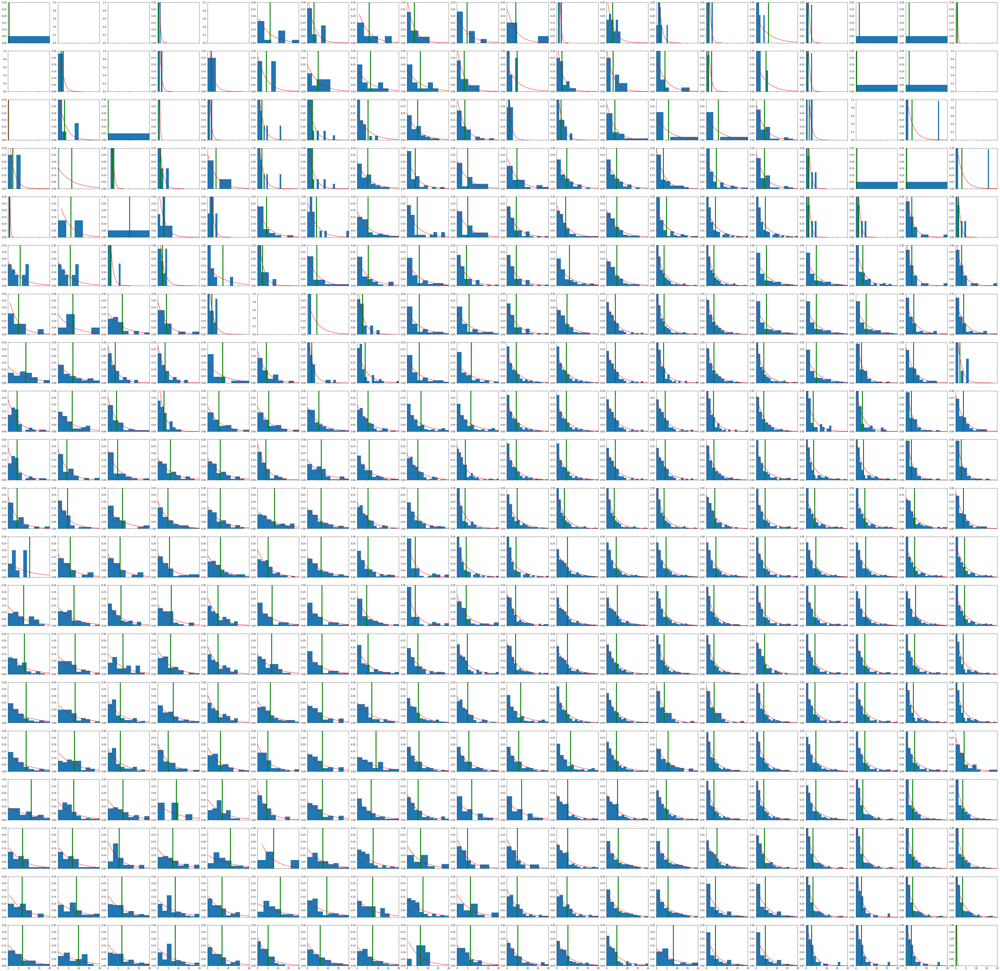

--- 329.04123401641846 seconds ---


In [34]:
start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = rad #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta


#creamos fig,axs
fig, axes = plt.subplots(20, 20, figsize=(80,80), sharex=True)


for u in range(0,20):
    for v in range(0,20): 
        total_obs = []

        pres_low = roundown(pres_w[u,v])
        pres_up = roundup(pres_w[u,v])
        if np.abs(pres_low - pres_w[u,v]) > 5:
            pres_low = pres_low + 5
        else:
            pres_up = pres_up - 5
        sst_low = np.floor(sst_w[u,v])
        sst_up = np.ceil(sst_w[u,v])
        if lat_w[u,v] <= roundlat(lat_w[u,v]):
            lat_low = roundlat(lat_w[u,v])-5
            lat_up = roundlat(lat_w[u,v])
        else:
            lat_low = roundlat(lat_w[u,v])
            lat_up = roundlat(lat_w[u,v])+5

        
        if pres_up <= 911:
            pres_up = 911
            pres_low = 800
        if pres_low >= 1010:
            pres_up = 1200
            pres_low = 1010
        if sst_up > 31:
            sst_up = 32
            sst_low = 31
        
        datos = data[((data.MinPressure > pres_low) & (data.MinPressure <=pres_up)) & ((data.SST > sst_low) &(data.SST <= sst_up)) 
     & ((data.Latitude > lat_low) & (data.Latitude <= lat_up))]
        
        
        dist = datos.Radius.values
        ang = datos.Theta.values
        pmin = datos.MinPressure.values
        lat = datos.Latitude.values
        sst = datos.SST.values
        prec = datos.Precipitation.values-1


                    
        i=0
        j=0
        
        if j == 30 and i == 36 :
            index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
        elif j == 30:
            index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
        elif i == 36:
            index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
        else:
            
            index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
        obs = prec[index] #cuando el index es un array vacío retorna nan, es decir no hay datos
        
        if len(obs) == 0:
            continue
            
        mu, sigma = stats.expon.fit(obs)
        points = np.linspace(stats.expon.ppf(0,loc=mu,scale=sigma),
                 stats.expon.ppf(0.9999,loc=mu,scale=sigma),100)
        pdf = stats.expon.pdf(points,loc=mu,scale=sigma)
        
        axes[19-u,v].hist(obs,bins = 'auto',range = (0,20),density = True)
        axes[19-u,v].axvline(np.nanmean(prec[index]),color='g', linewidth=4)
        axes[19-u,v].plot(points, pdf, color='r')
        axes[19-u,v].set_xlim(0,20)
        axes[19-u,v].set_ylim(0,0.3)

plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In [35]:
fig.savefig('histogram_fitted_centro.png')

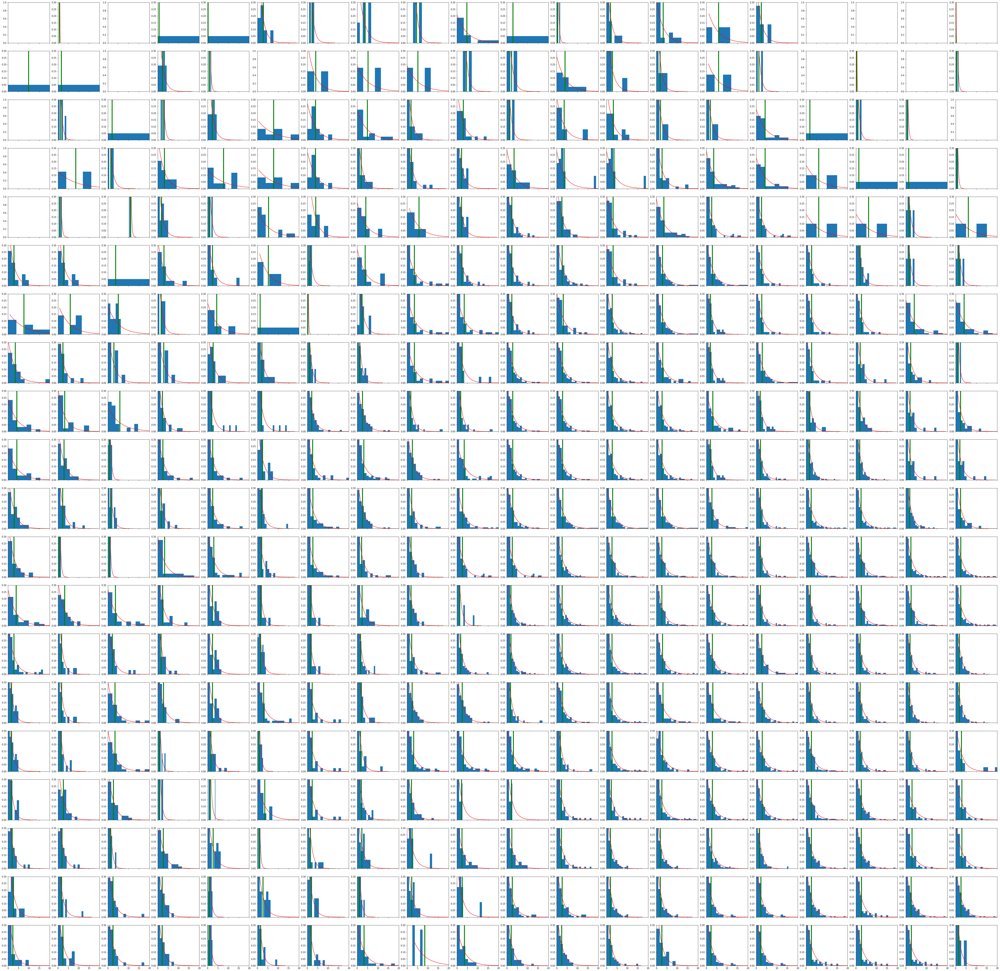

--- 331.5199189186096 seconds ---


In [36]:
start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = rad #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta


#creamos fig,axs
fig, axes = plt.subplots(20, 20, figsize=(80,80), sharex=True)


for u in range(0,20):
    for v in range(0,20): 
        total_obs = []

        pres_low = roundown(pres_w[u,v])
        pres_up = roundup(pres_w[u,v])
        if np.abs(pres_low - pres_w[u,v]) > 5:
            pres_low = pres_low + 5
        else:
            pres_up = pres_up - 5
        sst_low = np.floor(sst_w[u,v])
        sst_up = np.ceil(sst_w[u,v])
        if lat_w[u,v] <= roundlat(lat_w[u,v]):
            lat_low = roundlat(lat_w[u,v])-5
            lat_up = roundlat(lat_w[u,v])
        else:
            lat_low = roundlat(lat_w[u,v])
            lat_up = roundlat(lat_w[u,v])+5

        
        if pres_up <= 911:
            pres_up = 911
            pres_low = 800
        if pres_low >= 1010:
            pres_up = 1200
            pres_low = 1010
        if sst_up > 31:
            sst_up = 32
            sst_low = 31
        
        datos = data[((data.MinPressure > pres_low) & (data.MinPressure <=pres_up)) & ((data.SST > sst_low) &(data.SST <= sst_up)) 
     & ((data.Latitude > lat_low) & (data.Latitude <= lat_up))]
        
        
        dist = datos.Radius.values
        ang = datos.Theta.values
        pmin = datos.MinPressure.values
        lat = datos.Latitude.values
        sst = datos.SST.values
        prec = datos.Precipitation.values-1


                    
        i=0
        j=8
        
        if j == 30 and i == 36 :
            index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
        elif j == 30:
            index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
        elif i == 36:
            index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
        else:
            
            index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
        obs = prec[index] #cuando el index es un array vacío retorna nan, es decir no hay datos
        
        if len(obs) == 0:
            continue
            
        mu, sigma = stats.expon.fit(obs)
        points = np.linspace(stats.expon.ppf(0,loc=mu,scale=sigma),
                 stats.expon.ppf(0.9999,loc=mu,scale=sigma),100)
        pdf = stats.expon.pdf(points,loc=mu,scale=sigma)
        
        axes[19-u,v].hist(obs,bins = 'auto',range = (0,20),density = True)
        axes[19-u,v].axvline(np.nanmean(prec[index]),color='g', linewidth=4)
        axes[19-u,v].plot(points, pdf, color='r')
        axes[19-u,v].set_xlim(0,20)
        axes[19-u,v].set_ylim(0,0.3)

plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In [37]:
fig.savefig('histogram_fitted_medio.png')

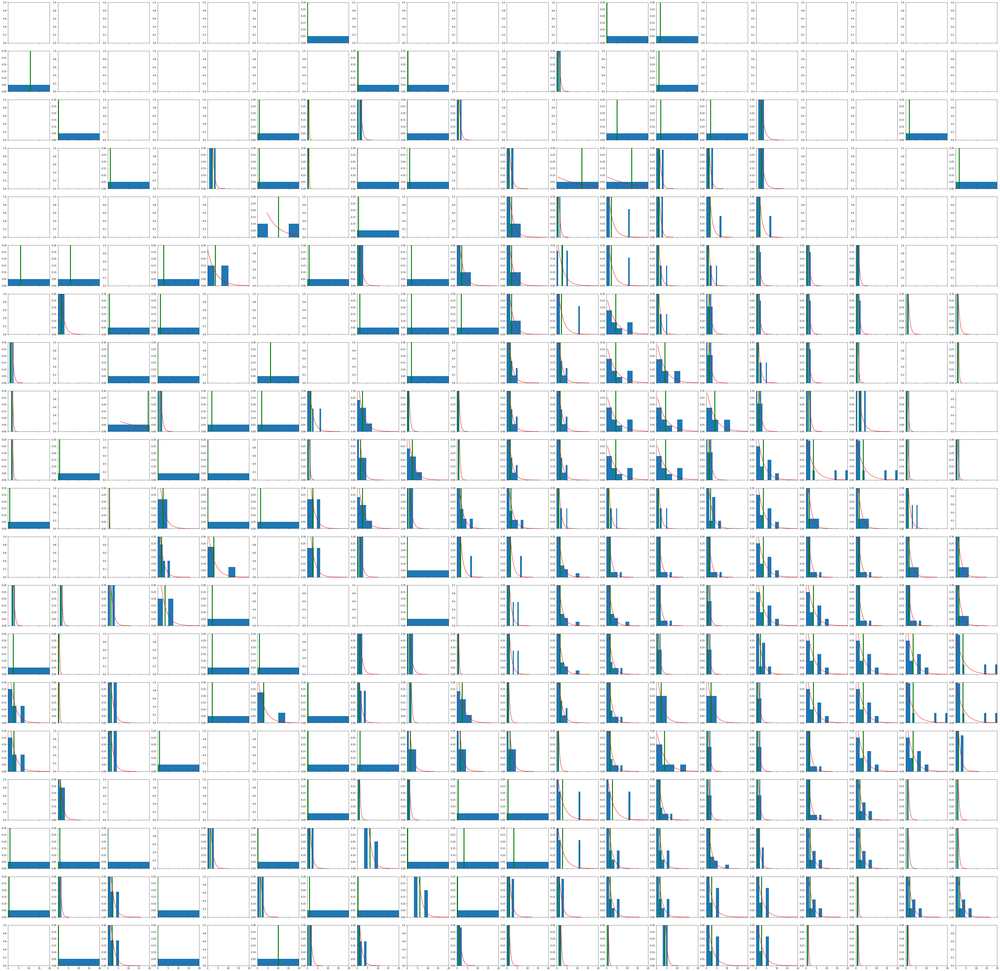

--- 318.07140469551086 seconds ---


In [38]:
start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = rad #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta


#creamos fig,axs
fig, axes = plt.subplots(20, 20, figsize=(80,80), sharex=True)


for u in range(0,20):
    for v in range(0,20): 
        total_obs = []

        pres_low = roundown(pres_w[u,v])
        pres_up = roundup(pres_w[u,v])
        if np.abs(pres_low - pres_w[u,v]) > 5:
            pres_low = pres_low + 5
        else:
            pres_up = pres_up - 5
        sst_low = np.floor(sst_w[u,v])
        sst_up = np.ceil(sst_w[u,v])
        if lat_w[u,v] <= roundlat(lat_w[u,v]):
            lat_low = roundlat(lat_w[u,v])-5
            lat_up = roundlat(lat_w[u,v])
        else:
            lat_low = roundlat(lat_w[u,v])
            lat_up = roundlat(lat_w[u,v])+5

        
        if pres_up <= 911:
            pres_up = 911
            pres_low = 800
        if pres_low >= 1010:
            pres_up = 1200
            pres_low = 1010
        if sst_up > 31:
            sst_up = 32
            sst_low = 31
        
        datos = data[((data.MinPressure > pres_low) & (data.MinPressure <=pres_up)) & ((data.SST > sst_low) &(data.SST <= sst_up)) 
     & ((data.Latitude > lat_low) & (data.Latitude <= lat_up))]
        
        
        dist = datos.Radius.values
        ang = datos.Theta.values
        pmin = datos.MinPressure.values
        lat = datos.Latitude.values
        sst = datos.SST.values
        prec = datos.Precipitation.values-1


                    
        i=0
        j=30
        
        if j == 30 and i == 36 :
            index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
        elif j == 30:
            index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
        elif i == 36:
            index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
        else:
            
            index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
        obs = prec[index] #cuando el index es un array vacío retorna nan, es decir no hay datos
        
        if len(obs) == 0:
            continue
            
        mu, sigma = stats.expon.fit(obs)
        points = np.linspace(stats.expon.ppf(0,loc=mu,scale=sigma),
                 stats.expon.ppf(0.9999,loc=mu,scale=sigma),100)
        pdf = stats.expon.pdf(points,loc=mu,scale=sigma)
        
        axes[19-u,v].hist(obs,bins = 'auto',range = (0,20),density = True)
        axes[19-u,v].axvline(np.nanmean(prec[index]),color='g', linewidth=4)
        axes[19-u,v].plot(points, pdf, color='r')
        axes[19-u,v].set_xlim(0,20)
        axes[19-u,v].set_ylim(0,0.3)
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In [39]:
fig.savefig('histogram_fitted_borde.png')

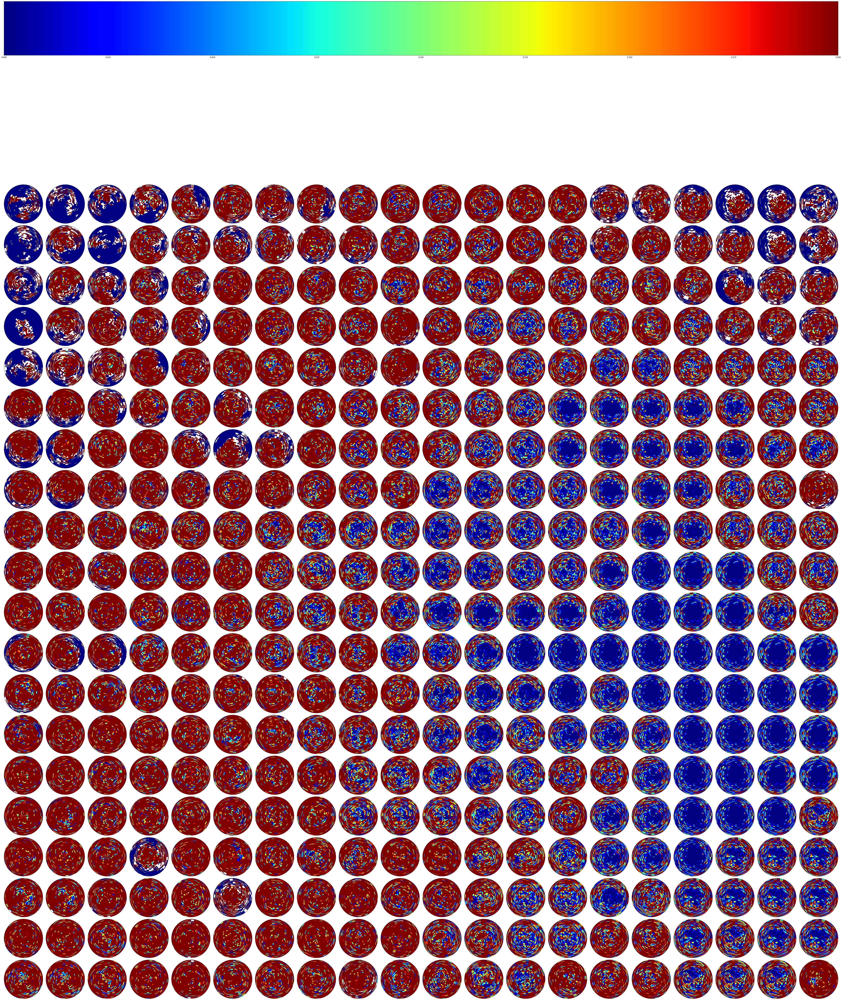

--- 1240.51806473732 seconds ---


In [41]:
start_time = time.time()
np.random.seed(1234)
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = rad #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta

# data = data[data.Precipitation <= 20]
#creamos fig,axs

fig, axes = plt.subplots(20, 20, figsize=(80,80), subplot_kw=dict(polar=True))


for u in range(0,20):
    for v in range(0,20): 
        total_obs = []

        pres_low = roundown(pres_w[u,v])
        pres_up = roundup(pres_w[u,v])
        if np.abs(pres_low - pres_w[u,v]) > 5:
            pres_low = pres_low + 5
        else:
            pres_up = pres_up - 5
        sst_low = np.floor(sst_w[u,v])
        sst_up = np.ceil(sst_w[u,v])
        if lat_w[u,v] <= roundlat(lat_w[u,v]):
            lat_low = roundlat(lat_w[u,v])-5
            lat_up = roundlat(lat_w[u,v])
        else:
            lat_low = roundlat(lat_w[u,v])
            lat_up = roundlat(lat_w[u,v])+5

        
        if pres_up <= 920:
            pres_up = 920
            pres_low = 800
        if pres_low >= 1000:
            pres_up = 1200
            pres_low = 1000
        if sst_up > 31:
            sst_up = 32
            sst_low = 31
        
        datos = data[((data.MinPressure > pres_low) & (data.MinPressure <=pres_up)) & ((data.SST > sst_low) &(data.SST <= sst_up)) 
     & ((data.Latitude > lat_low) & (data.Latitude <= lat_up))]
        
#         datos = data[(data.MinPressure == pres_w[u,v].astype(int)) & ((np.round(data.Latitude) == np.round(lat_w[u,v]))) & ((np.round(data.SST) == np.round(sst_w[u,v])))]
        
        dist = datos.Radius.values
        ang = datos.Theta.values
        pmin = datos.MinPressure.values
        lat = datos.Latitude.values
        sst = datos.SST.values
        prec = datos.Precipitation.values - 1


        obs = np.zeros((r.shape))
                    
        for i in range(obs.shape[0]):
            for j in range(obs.shape[1]):
                if j == 30 and i == 36 :
                    index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                elif j == 30:
                    index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                elif i == 36:
                    index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                else:
            
                    index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                
                if len(index) == 0:
                    continue
                else:
                    mu, sigma = stats.expon.fit(prec[index])
                    obs[i,j] = stats.kstest((prec[index]),'expon',N = len(index), args = (mu,sigma))[1]
            
        total_obs.append(obs)

        if len(datos) == 0:
        
            axes[19-u,v].set_theta_zero_location('N', offset=0)

            axes[19-u,v].set_theta_direction(-1)
    
            axes[19-u,v].set_yticklabels([])
    
            axes[19-u,v].set_xticklabels([])
        else:
        
            im = axes[19-u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='jet',vmin=0,vmax=0.2)

            axes[19-u,v].set_theta_zero_location('N', offset=0)

            axes[19-u,v].set_theta_direction(-1)
    
            axes[19-u,v].set_yticklabels([])
    
            axes[19-u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))

In [42]:
fig.savefig('ks_test_expon.png')

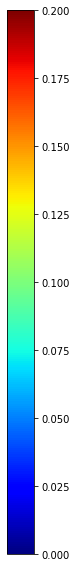

In [43]:
fig,ax = plt.subplots(figsize=(10,10))
plt.colorbar(im,ax=ax)
ax.remove()
fig.savefig('scale_ks_0-2.png')